# UFRJ Analytica - Processo Seletivo 2022

Por Marcos Eduardo

## Introdução

O Citi Bike é um sistema público de compartilhamento de bicicletas de propriedade privada que atende os bairros de Nova York do Bronx, Brooklyn, Manhattan e Queens, bem como Jersey City, Nova Jersey e Hoboken. Foi inaugurado oficialmente em maio de 2013 com 332 estações e 6.000 bicicletas. 

Em outubro de 2017 o sistema atingiu um total de 50 milhões de corridas e em julho de 2020 o sistema atingiu 100 milhões de corridas.

## Bibliotecas

In [27]:
import numpy as np 
import pandas as pd 
import plotly.express as px
import seaborn as sns
import matplotlib.pyplot as plt
import sys
import plotly.graph_objects as go

## Descrição das Features

O nosso conjunto de dados é descrito da seguinte forma:

|Atributo       | Descrição     |
|---------------|:-------------:|
| tripduration            |   Duração da viagem em segundos | 
| starttime |   Início da viagem | 
| stoptime          |   Fim da Viagem   | 
| start station name   |   Nome da estação onde a viagem começou|
| end station name   |   Nome da estação onde a viagem terminou|
| start station latitude / start station longitude      |   Localização onde a viagem começou|
| end station latitude /end station longitude            |   Localização onde a viagem terminou   |
| Bike ID        |  ID da bicicleta  |
| usertype    |   Customer = passe de 24 horas ou 3 dias; Subscriber = Membro Anual |
| birth year         |   Ano de nascimento|
| gender     |   Zero=unknown; 1=masculino; 2=feminino |


Os dados foram retirados do kaggle: [New York City Bike Share Dataset](https://www.kaggle.com/datasets/akkithetechie/new-york-city-bike-share-dataset).

## Análise Prelimiar

### Limpeza e Tratamento de Dados

In [28]:
#importar dados
df = pd.read_csv('data_bike2019.csv')
df.describe()

,tripduration,start station id,start station latitude,start station longitude,end station id,end station latitude,end station longitude,bikeid,birth year,gender
count,4.049470e+05,404947.000000,404947.000000,404947.000000,404947.000000,404947.000000,404947.000000,404947.000000,404947.000000,404947.000000
mean,7.258427e+02,3294.022391,40.722722,-74.046333,3292.219142,40.722328,-74.045792,28465.511998,1981.417524,1.162335
std,9.785237e+03,171.021930,0.007037,0.010871,180.886426,0.006885,0.010829,1654.373618,10.257440,0.516120
min,6.100000e+01,3183.000000,40.709651,-74.083639,116.000000,40.695065,-74.083639,14792.000000,1887.000000,0.000000
25%,2.330000e+02,3195.000000,40.718355,-74.050444,3192.000000,40.718355,-74.050389,26286.000000,1975.000000,1.000000
50%,3.450000e+02,3210.000000,40.721525,-74.043845,3207.000000,40.721124,-74.043117,29284.000000,1984.000000,1.000000
75%,5.800000e+02,3276.000000,40.727224,-74.038051,3276.000000,40.727224,-74.038051,29536.000000,1989.000000,1.000000
max,2.566420e+06,3792.000000,40.748716,-74.032108,3792.000000,40.814326,-73.932077,41913.000000,2003.000000,2.000000


Em uma análise parcial, podemos notar que o `birth year` possui um valor minimo fora do normal.

In [29]:
# Verificando tamanho
linhas, colunas = df.shape
print(f"Total de linhas: {linhas}\nTotal de colunas: {colunas}")

Total de linhas: 404947
Total de colunas: 15


Uma pequena amostro dos dados que estamos trabalhando.

In [30]:
df.sample(3)

,tripduration,starttime,stoptime,start station id,start station name,start station latitude,start station longitude,end station id,end station name,end station latitude,end station longitude,bikeid,usertype,birth year,gender
139771,186,2019-06-07 08:58:37.5790,2019-06-07 09:01:44.4940,3639,Harborside,40.719252,-74.034234,3184,Paulus Hook,40.714145,-74.033552,29523,Subscriber,1997,1
386751,506,2019-12-04 07:35:45.9950,2019-12-04 07:44:12.0120,3681,Grand St,40.715178,-74.037683,3202,Newport PATH,40.727224,-74.033759,29609,Subscriber,1959,2
241569,284,2019-08-18 10:57:43.4990,2019-08-18 11:02:27.7780,3194,McGinley Square,40.725340,-74.067622,3195,Sip Ave,40.730897,-74.063913,29297,Subscriber,1984,2


In [31]:
df.info() #Verificando tipo de dados

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 404947 entries, 0 to 404946
Data columns (total 15 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   tripduration             404947 non-null  int64  
 1   starttime                404947 non-null  object 
 2   stoptime                 404947 non-null  object 
 3   start station id         404947 non-null  int64  
 4   start station name       404947 non-null  object 
 5   start station latitude   404947 non-null  float64
 6   start station longitude  404947 non-null  float64
 7   end station id           404947 non-null  int64  
 8   end station name         404947 non-null  object 
 9   end station latitude     404947 non-null  float64
 10  end station longitude    404947 non-null  float64
 11  bikeid                   404947 non-null  int64  
 12  usertype                 404947 non-null  object 
 13  birth year               404947 non-null  int64  
 14  gend

In [32]:
print(f"Total de linhas duplicadas: {df.duplicated().sum()}") # Verificando existencia de linhas duplicadas
df = df.drop_duplicates() # Remoção das duplicatas

Total de linhas duplicadas: 0


In [33]:
df.isnull().sum() # Verificando campos nulos

tripduration               0
starttime                  0
stoptime                   0
start station id           0
start station name         0
start station latitude     0
start station longitude    0
end station id             0
end station name           0
end station latitude       0
end station longitude      0
bikeid                     0
usertype                   0
birth year                 0
gender                     0
dtype: int64

In [34]:
df['bikeid'].count() # Total de usuarios que alugaram bicicletas em 2020

404947

In [35]:
# Removendo colunas desnecessárias
df.drop(['start station id', 'end station id'],axis=1,inplace=True)

#### Alterando os tipos de dados

In [36]:
# string para datatime
df['birth year'] = pd.to_numeric(df['birth year'], downcast='integer')
df['starttime'] = pd.to_datetime(df['starttime'])
df['stoptime'] = pd.to_datetime(df['stoptime'])
# integer para category
df['gender'] = df['gender'].astype('category')

### Calculando a idade

Como o nosso conjuneto de dados é do ano de 2019, usaremos esse ano como base das idades.

In [37]:
df['age'] = 2019-df['birth year']

## Análise Exploratória

Temos `40.4947` usuários que alugaram bicicletas em 2019. A viagem mais longa foi de `2.566.420` segundos.

### Extraindo dia, dias da semana e hora do dataset

In [38]:
df['start_month'] = df['starttime'].dt.month_name()        #Extraindo mês
df['start_hours'] = df['starttime'].dt.hour                # Extraindo hora
df['start_weekday'] = df['starttime'].dt.weekday           # Extraindo dia da semana 
df['start_weekday_name'] = df['starttime'].dt.day_name()   # Extraindo nome do dia da semana
df['tripduration_in_min'] = df['tripduration'].apply(lambda x: round(x/60))     # Criando duração em minutos

## Exploração 

### Duração da Viagem

In [39]:
desc = df['tripduration'].describe()
desc

count    4.049470e+05
mean     7.258427e+02
std      9.785237e+03
min      6.100000e+01
25%      2.330000e+02
50%      3.450000e+02
75%      5.800000e+02
max      2.566420e+06
Name: tripduration, dtype: float64

A duração máxima de uma viagem com `2.566.420` segundos, não é atipica. Em um conversão rápida, temos `42.773` minutos e `712` horas.

In [40]:
# Calculando limite superior do boxplot
Q1 = desc[4]
Q3 = desc[6]
IQR = Q3-Q1
upper_bound = Q3 + 1.5*IQR
print(f"Limite Superior: {upper_bound}")

Limite Superior: 1100.5


##### Análise estatística

- Cerca de 75% do tempo, os ciclistas gastam em torno de `580` segundos ou `9,6` minutos na viagem
- Os ciclistas andam de bicicleta por pelo menos `61` segundos.
- Em média, `725,8` segundos, o que significa `12` minutos.

Vamos considerar nessa análise, que a `duração máxima` do uso das bicicletas não vão ultrapassar `24` horas.

In [41]:
# Verificando quantidade de viagens acima de 24horas
df[df['tripduration'] >=24*60*60].shape

(150, 19)

In [42]:
# Duração máxima de 1 dia
df = df[df['tripduration'] <=24*60*60]

### Verificando Estações

In [201]:
endStation = df[['end station name', 'end station longitude', 'end station latitude']].drop_duplicates()
startStation= df[['start station name', 'start station longitude', 'start station latitude']].drop_duplicates()

In [221]:
fig = px.scatter_mapbox(endStation, lat="end station latitude", lon="end station longitude", hover_name = "end station name",
                 width=900, height=600, zoom=12, mapbox_style="carto-positron")

fig.add_trace(go.Scattermapbox(
        lat=startStation['start station latitude'],
        lon=startStation['start station longitude'],
        mode='markers',
        name="start station name",
        marker=go.scattermapbox.Marker(
            size=5,
            color='rgb(0, 255,0)',
            opacity=0.7
        ),
        text=startStation['start station name'],
        hoverinfo='text'
    ))
fig.update_layout(
                    margin={"r":0,"t":0,"l":0,"b":0},
                    showlegend=False)
fig.show()

Nosso conjunto de dados foi fornecido para a `Jersey City`, logo as estações em `azul` não deveriam fazer parte do nosso conjuto. A estação de New York mais próxima de Jersey é a `West Thames St`, vamos usar sua longitude para remover individuos com a longetude menor.

In [225]:
df = df[df['end station longitude'] < -74.018]

#### Distribuição duração viagem (tempo de uso)

Como vimos nosso limite superior é de `1100.5` segundos, ou seja, `18` minutos. Vamos vizualiar a distribuição do uso limitado em até `60` minutos.

In [43]:
# Tempo de uso em minutos com limitado em 60 min
fig = px.histogram(df, x="tripduration_in_min")
fig.update_layout(xaxis_range=[1,60])
fig.show()

A concentração das viagem esta entre `1` e `40` minutros. Tendo um pico em 4 minutos.

In [44]:
# fig = px.histogram(df, x="tripduration", color="start_weekday_name", log_x=True)
# fig.show()

###  Verificando idades dos clientes

In [45]:
df['age'].describe()

count    404797.000000
mean         37.581635
std          10.256967
min          16.000000
25%          30.000000
50%          35.000000
75%          44.000000
max         132.000000
Name: age, dtype: float64

Uma média de `37` anos, sendo o mais novo com 16 anos e o mais velho com 132 anos.

In [50]:
# Verificando quantidades de pessoas com mais de 100 anos
df[df['age'] > 100].shape[0]

197

Nosso limite superior para idade é de 65 anos, porem vamos permitir alguns outlirs. Limitando a idade em 70 anos.

In [59]:
#Removendo idade menores que 70
df = df[df['age'] <=70]

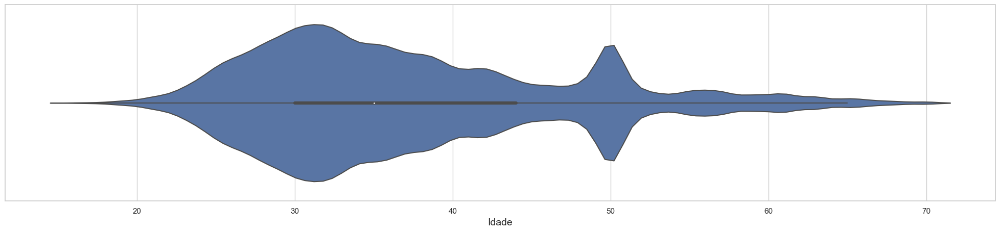

In [60]:
plt.figure(figsize = (25,5))
sns.violinplot(x='age', data=df)
plt.xlabel('Idade', fontsize=14)
plt.show()

### Média de viagens por idade

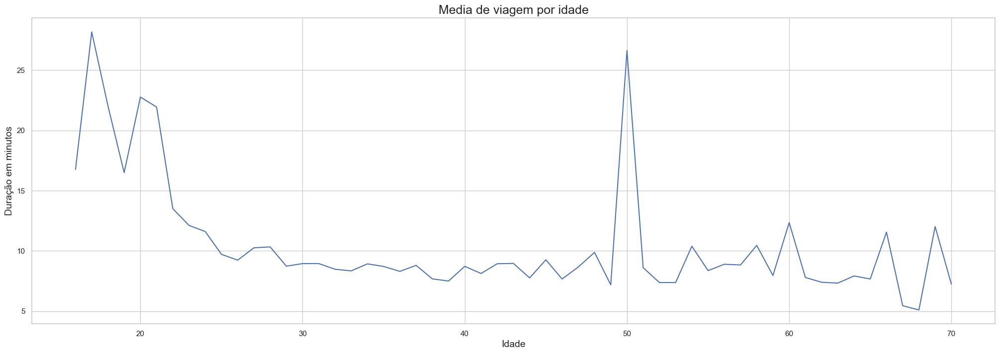

In [62]:
# Media de viagem por idade
plt.figure(figsize = (25,8))

plt.title('Media de viagem por idade', fontsize=18)
plt.xlabel('Idade', fontsize=14)
plt.ylabel('Duração em minutos', fontsize=14)

average_trip = df.groupby('age')['tripduration_in_min'].mean().reset_index().rename(columns={'age': 'idade', 'tripduration_in_min':'media'})
sns.lineplot(data =average_trip, x='idade', y='media')
plt.show()


### Dividindo as idades em grupos

In [69]:
df['ageGroup']= pd.cut(
   df['age'],
   bins=[0, 20, 30, 40, 50, 60, sys.maxsize],
   labels=['<20', '20-29', '30-39', '40-49', '50-59', '60+']
)

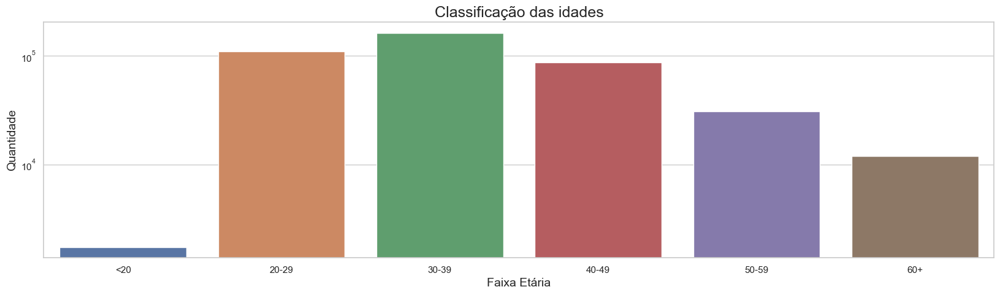

In [70]:
plt.figure(figsize = (20,5))
ax = sns.countplot(x=df["ageGroup"])
ax.get_figure().get_axes()[0].set_yscale('log')
plt.title('Classificação das idades', fontsize=18)
plt.xlabel('Faixa Etária', fontsize=14)
plt.ylabel('Quantidade', fontsize=14)
plt.show()

### Como é a proporção da idade por dia de semana?

In [74]:
weekOrder = ['Sunday', 'Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday']
fig = px.histogram(df, x="start_weekday_name",
             color='ageGroup', barmode='group',
             height=400, title='Idade x Dia da semana', log_y=True)
fig.update_xaxes(categoryorder='array', categoryarray= weekOrder)

fig.show()

Podemos notar que a concentração para todas as idades está na `quinta-feira`, cosequentemente podendo gerar um `pico` nesse dia da semana.

### Média de duração do uso por mês

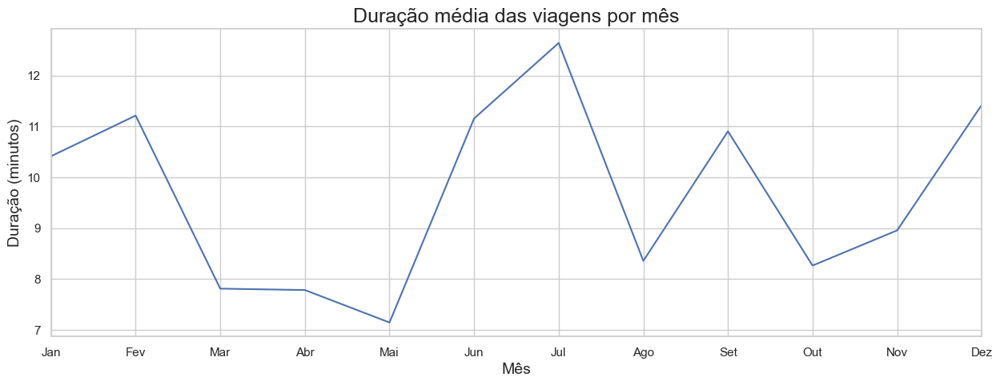

In [96]:
plt.figure(figsize = (15,5))

ax = df.groupby('start_month')['tripduration_in_min'].mean().plot()
ax.set_xlim(0, 11)
plt.xticks(range(0,12), ['Jan', 'Fev', 'Mar', 'Abr', 'Mai', 'Jun', 'Jul', 'Ago', 'Set', 'Out', 'Nov', 'Dez'])

plt.title('Duração média das viagens por mês', fontsize=18)
plt.xlabel('Mês', fontsize=14)
plt.ylabel('Duração (minutos)', fontsize=14)
plt.show()

`Julho` é o mês com viagens mais domorada em média, uma possivel justificativa para isso, seja o feriado 4 julho que comemora a independência dos EUA.

In [85]:
july = df[df['start_month'] == 'July'].copy()
july['start_day']= july['starttime'].dt.day

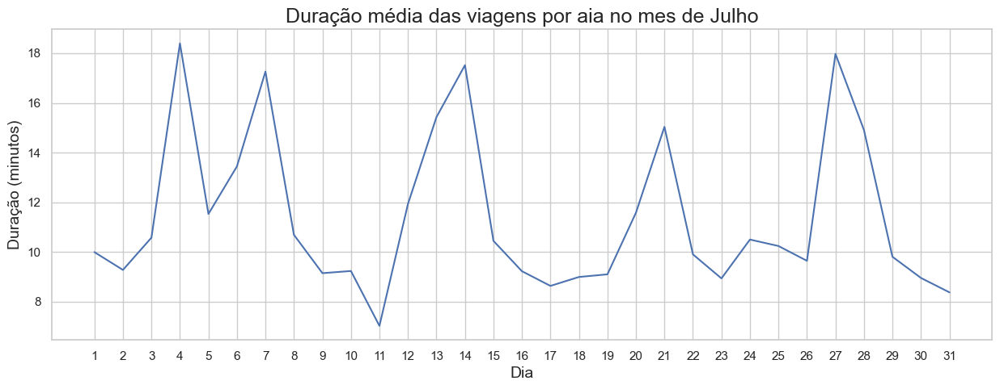

In [95]:
plt.figure(figsize = (15,5))
plt.xticks(range(1,32))

ax = july.groupby('start_day')['tripduration_in_min'].mean().plot()

plt.title('Duração média das viagens por aia no mes de Julho', fontsize=18)
plt.xlabel('Dia', fontsize=14)
plt.ylabel('Duração (minutos)', fontsize=14)
plt.show()

Como suspeitado, dia 4 de julho foi o dia com maior duração média nas viagens.

### Tipos de clientes

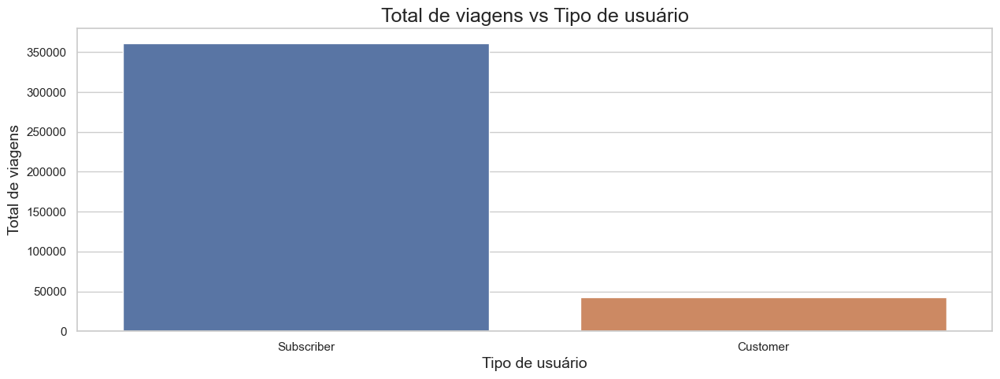

In [100]:
plt.figure(figsize = (15,5))
ax = sns.countplot(data= df, x = 'usertype', order = df['usertype'].value_counts().index)
plt.xlabel('Tipo de usuário', fontsize=14)
plt.ylabel('Total de viagens', fontsize=14)
plt.title('Total de viagens vs Tipo de usuário', fontsize=18)
plt.show()

Temos mais clientes assinantes, do que clientes avulsos/Temporários.

### Proporção dos Gênero

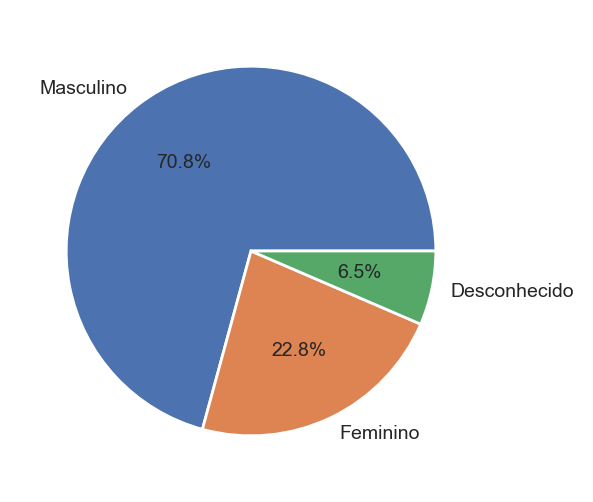

In [101]:
plt.figure(figsize=(3,3), dpi=200)
mylabels = ["Masculino", "Feminino", "Desconhecido"]

plt.pie(df['gender'].value_counts(), labels = mylabels, autopct='%1.1f%%', textprops={'fontsize': 7})
plt.show() 

### Relação Idade e Gênero

In [108]:
# Criando uma nova tabela com idade e gêneros
gender_age = pd.crosstab(index=df['gender'], columns=df['ageGroup'], rownames=['gender'], colnames=['Faixa Etaria'])
gender_age = pd.DataFrame(gender_age) 
gender_age = gender_age.rename(index={1: 'Masculino', 2: 'Feminino', 0: 'Desconhecido'}) #Adicionando nomes as linhas
gender_age = (gender_age / len(df)).round(2)

In [109]:
# Cada bloco mostra a porcentagem das viagens que foram feitas por essa idade + gênero
# Somando todas temos 1.0, equivalente a 100%
gender_age

Faixa Etaria,<20,20-29,30-39,40-49,50-59,60+
gender,,,,,,
Desconhecido,0.0,0.00,0.0,0.06,0.00,0.00
Masculino,0.0,0.19,0.3,0.13,0.06,0.02
Feminino,0.0,0.08,0.1,0.03,0.01,0.01


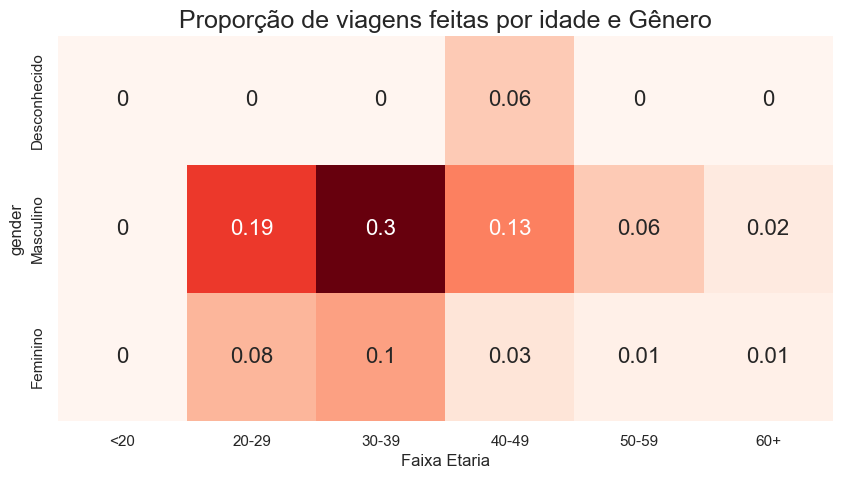

In [110]:
plt.figure(figsize = (10,5))
ax = sns.heatmap(gender_age, annot=True, linewidths=0, cbar=False, cmap="Reds", annot_kws={"size": 16})
ax.set_title('Proporção de viagens feitas por idade e Gênero', fontsize=18)
plt.show()


O nosso dataset possui `32%` de homens com faixa etária de `30 a 39 anos`. Enquanto temos `9%` para mulheres na mesma faixa etária.

#### Viagens durante a semana por gênero

In [111]:
fig = px.histogram(df, x="start_weekday_name",
             color='gender', barmode='group',
             height=400, labels={0: "Desconhcido", 1: "Masculino", 2: "Feminino"})
fig.update_xaxes(categoryorder='array', categoryarray= weekOrder)
fig.update_layout(legend_title_text='Gênero')
fig.show()

Os homems vão predomina todos os dia da semana, com um destaque na quinta-feira junto das mulheres. Já o desconhecido aproveita os finais de semana.

## Como a hora do dia afeta a disponibilidade das bicicletas?

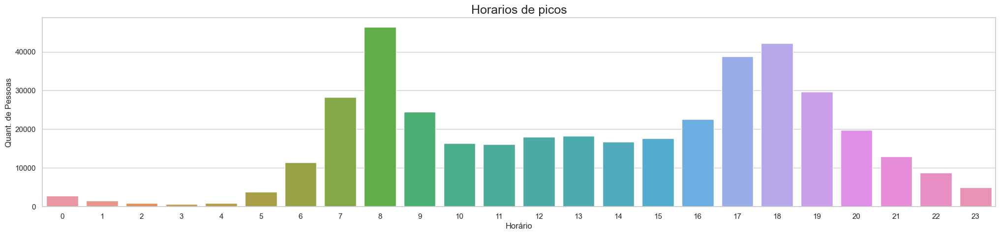

In [112]:
plt.figure(figsize = (25,5))
ax = sns.countplot(x=df["start_hours"])
ax.set(xlabel='Horário', ylabel='Quant. de Pessoas')
plt.title('Horarios de picos', fontsize=18)
plt.show()

É notório que o horário das `8h` é o mais procurado para alugar uma bicicleta, seguido do horário das `18h`. Podemos partir da `hipótese` que o motivo para isso, seja a ida e vinda do trabalho.

#### Tem diferença no pico para tipos diferentes de usuário?

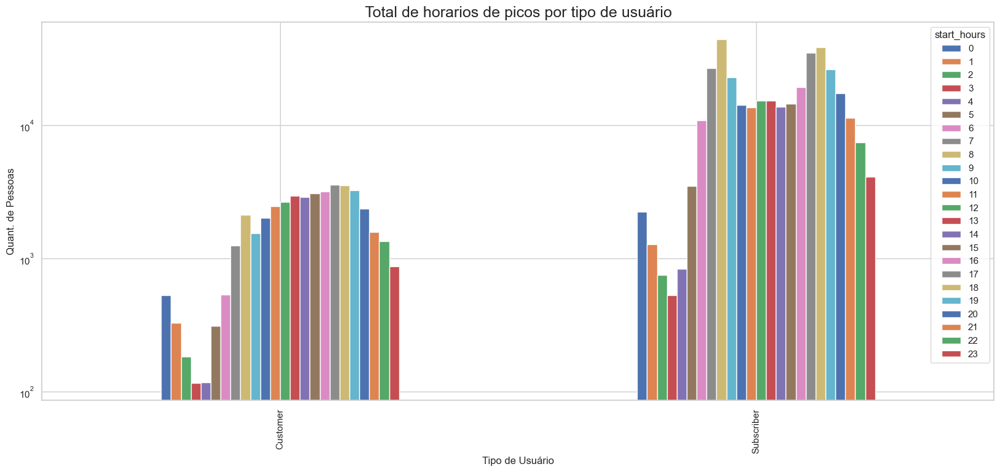

In [113]:
# Horario de picos por tipo de usuário
day=range(0,24)
count_usertype = df.groupby(['usertype','start_hours']).size().unstack()
ax = count_usertype.plot(kind = 'bar',figsize=(20,8))
ax.set(xlabel='Tipo de Usuário', ylabel='Quant. de Pessoas')
ax.get_figure().get_axes()[0].set_yscale('log')
plt.title('Total de horarios de picos por tipo de usuário', fontsize=18)
plt.show()

Temos diferença no pico para cada tipo de usuário, podemos ver que o pico das `8h` esta mais relacionado aos clientes inscritos, enquanto os clientes "normais" preferem os horarios de `4h` e `5h`. Fortalecendo nossa hipótese se pensamos que os ciclistas que usam para trabalho possue uma inscrição anual, afim de economizar com as idas e vindas do trabalho.

#### Há diferença entre dia de semana e finais de semana?

In [114]:
# Separando dia util de final de semana
weekType = np.where(df['start_weekday'] < 5, 'Weekday', 'Weekend')

In [115]:
# Calculando a quantidades de horas para o dia da semana (Seg-Sex)
weekday = df[weekType == 'Weekday']
weekday = weekday['start_hours'].value_counts().sort_index()

# Calcuando para o final de semana
weekend = df[weekType != 'Weekday']
weekend = weekend['start_hours'].value_counts().sort_index()

# Calculo total
week_all = df['start_hours'].value_counts().sort_index()

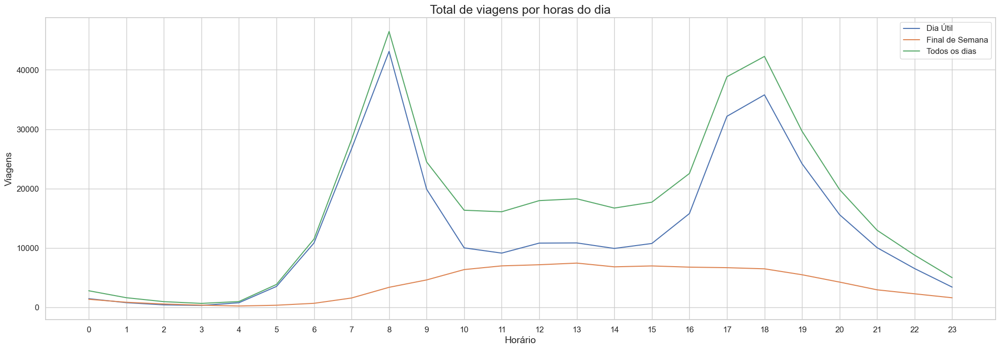

In [116]:
plt.figure(figsize = (25,8))
plt.plot(weekday)
plt.plot(weekend)
plt.plot(week_all)
plt.legend(['Dia Útil', 'Final de Semana', 'Todos os dias'], fontsize=12)
plt.xticks(range(0,24),weekday.index, fontsize=10)
plt.tick_params(axis='both', which='major', labelsize=12)

#labels
plt.title('Total de viagens por horas do dia', fontsize=18)
plt.xlabel('Horário', fontsize=14)
plt.ylabel('Viagens', fontsize=14)
plt.show()

Os picos 8h e 18h se mantiveram durante os dia de semana. Enquanto finais de semana a procura é mais pelo turno da tarde, um horário mais voltado para o lazer.

### Existe dia de pico durante a semana?

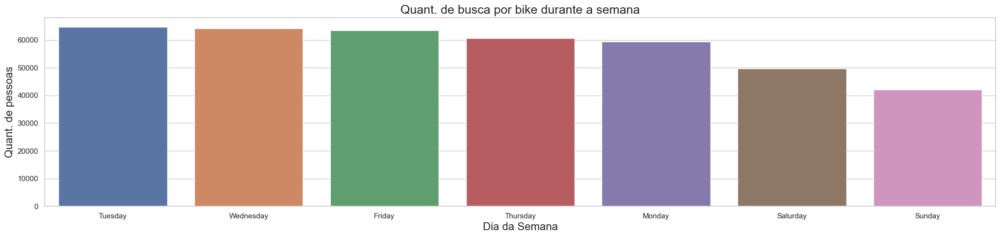

In [118]:
plt.figure(figsize = (25,5))
ax = sns.countplot(data= df, x = 'start_weekday_name', order = df['start_weekday_name'].value_counts().index)
plt.xlabel('Dia da Semana', fontsize=16)
plt.ylabel('Quant. de pessoas', fontsize=16)
plt.title('Quant. de busca por bike durante a semana', fontsize=18)
plt.show()

`Quinta-Feira` é o dia mais procurado, mas o interessante aqui é que a demandas pelas bicicletas são durante a `semana útil` e nos `finais de semana` ela diminui.

### O tempo de viagem tem alguma relação com a idade?

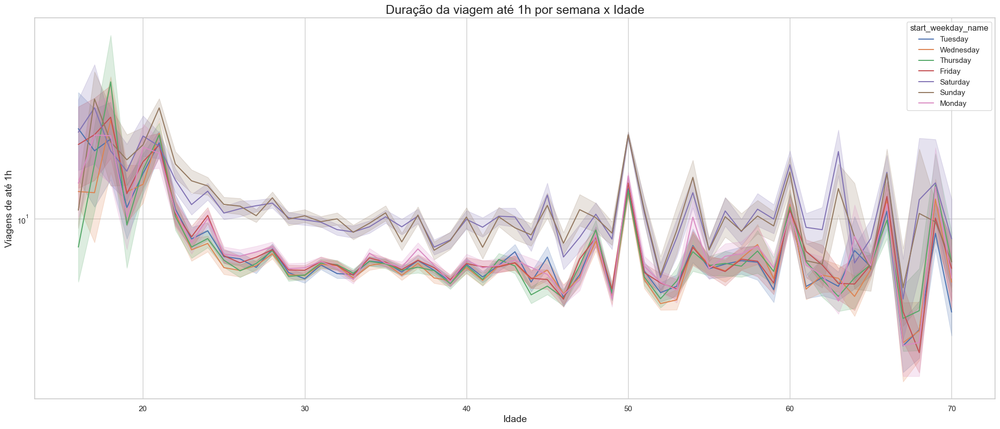

In [119]:
# Verificando duração da viagem por dia da semana em relação a idade
plt.figure(figsize = (25,10))
ax = sns.lineplot(y='tripduration_in_min', x='age', data=df[df['tripduration_in_min'] < 61], hue='start_weekday_name')
ax.get_figure().get_axes()[0].set_yscale('log')
plt.title('Duração da viagem até 1h por semana x Idade', fontsize=18)
plt.xlabel('Idade', fontsize=14)
plt.ylabel('Viagens de até 1h', fontsize=14)
plt.show()

Independente da idade, as clientes costumam ter viagens mais longas no `domingo`, vamos confirmar isso no próximo grafico.

### Dia da semana com viagens mais longas

In [120]:
dfWeek = pd.DataFrame()
dfWeek['Week Name'] = df['start_weekday_name']
dfWeek['tripduration'] = df['tripduration']
dfWeek = dfWeek.groupby(['Week Name']).sum().reset_index()

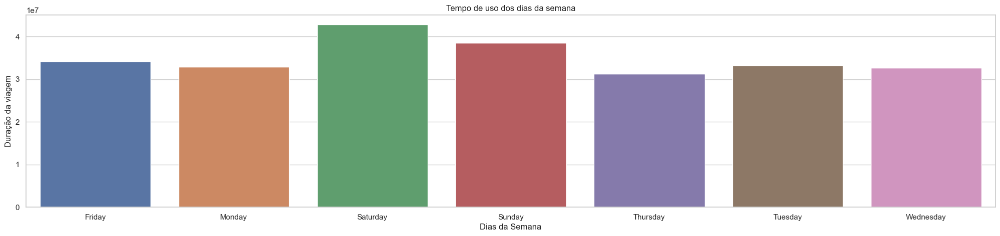

In [121]:
plt.figure(figsize = (25,5))
ax = sns.barplot(data =dfWeek ,x='Week Name',
       y='tripduration')
ax.set(xlabel='Dias da Semana', ylabel='Duração da viagem', title='Tempo de uso dos dias da semana')
plt.show()

Como vimos anteriormente, `Domingo` é quando as pessoas curtem mais as viagens.

## Pontos de Estações 

In [122]:
# Número de estações
print('Quantidade de estações: ',df['start station name'].nunique())

Quantidade de estações:  53


### As 10 estações mais populares

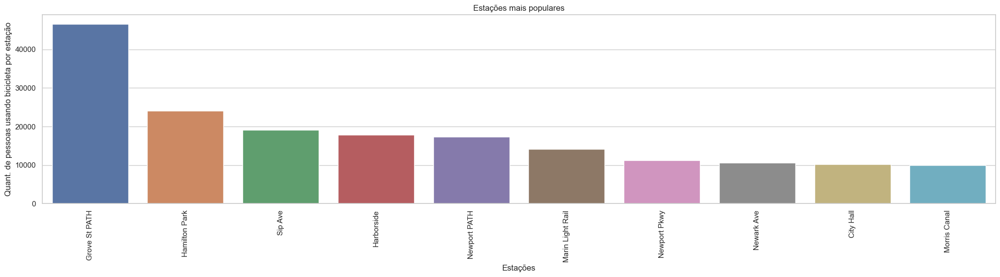

In [234]:
topStartStation = df["start station name"].value_counts().head(10)
plt.figure(figsize = (25,5))
ax = sns.barplot(x=topStartStation.index,
       y=topStartStation)
ax.set(xlabel='Estações', ylabel='Quant. de pessoas usando bicicleta por estação', title='Estações mais populares')
plt.xticks(rotation=90)
plt.show()

In [240]:
df.groupby(['start station name','start station latitude', 'start station longitude']).size().reset_index()['start station name'].duplicated()

0     False
1     False
2     False
3     False
4     False
5     False
6     False
7     False
8     False
9     False
10    False
11    False
12    False
13    False
14    False
15    False
16    False
17    False
18    False
19    False
20    False
21    False
22    False
23    False
24    False
25    False
26    False
27    False
28    False
29    False
30    False
31    False
32    False
33    False
34    False
35    False
36    False
37    False
38    False
39    False
40    False
41    False
42    False
43    False
44    False
45    False
46    False
47    False
48     True
49    False
50    False
51    False
52    False
53    False
Name: start station name, dtype: bool

### Estações mais populares no mapa

In [236]:
stations = df.groupby(['start station latitude', 'start station longitude', 'start station name']).size().reset_index(name = 'Amount People')
stations = stations.sort_values('Amount People',ascending = False)

fig = px.scatter_mapbox(stations, lat="start station latitude", lon="start station longitude", hover_name = "start station name", color = "Amount People",
                  size = "Amount People", color_continuous_scale=px.colors.cyclical.IceFire,width=900, height=600, zoom=12.5, mapbox_style="carto-positron",
                    )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

Nosso conjunto de dados possuem mais dados sobre a cidade de `Jersey`, poucas pessoas vão para `New York` até porque o tunel mais perto não sei se seria uma travessia facil para os ciclistas.

### Qual a difereça de faixa etária nas 10 estações mais populares?

In [157]:
df_age = pd.DataFrame(df[['start station name','ageGroup']].value_counts()).reset_index().rename(columns={'start station name': 'estacao', 'ageGroup': 'faixa etaria', 0:'quant'})
df_age = df_age.drop_duplicates(['estacao'])
df_age.head(10)

,estacao,faixa etaria,quant
0,Grove St PATH,30-39,8785
1,Newport Pkwy,20-29,6466
3,Marin Light Rail,30-39,5276
4,Liberty Light Rail,50-59,5020
8,Hamilton Park,30-39,4641
9,Sip Ave,30-39,4623
10,Newport PATH,20-29,4563
11,Harborside,30-39,4187
16,City Hall,30-39,3632
18,Columbus Dr at Exchange Pl,30-39,3491


Incrivelmente a faixa estária de `30-39` anos está predominando.

### Qual seria o mês com mais viagens?

In [158]:
bf = pd.DataFrame(df['starttime'].value_counts())
bf.index = pd.to_datetime(bf.index)
bf.sort_index(inplace = True)
bf.rename(columns={'starttime':'quant'}, inplace = True)

O dataset possui dados do final de 2015 até inicio de 2017. Poderiamos pegar so o ano de 2016 e analisar, porem veremos todos os dados.

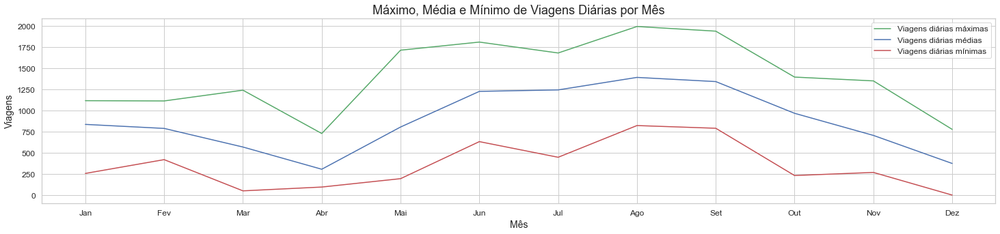

In [160]:
#grafico da média, maxima e minimo diario por mês de final de 2016 até inicio de 2017
a = bf.resample('D').sum().resample('M').max().reset_index(drop=True)
b = bf.resample('D').sum().resample('M').mean().reset_index(drop=True)
c = bf.resample('D').sum().resample('M').min().reset_index(drop=True)
plt.figure(figsize = (25,5))
plt.plot(a, 'g')
plt.plot(b, 'b')
plt.plot(c, 'r')

plt.legend(['Viagens diárias máximas', 'Viagens diárias médias', 'Viagens diárias mínimas'], fontsize=12)
plt.xticks(range(0,12),['Jan', 'Fev', 'Mar', 'Abr', 
                        'Mai', 'Jun', 'Jul', 'Ago', 'Set', 'Out', 'Nov', 'Dez'])
plt.tick_params(axis='both', which='major', labelsize=12)

plt.title('Máximo, Média e Mínimo de Viagens Diárias por Mês', fontsize=18)
plt.xlabel('Mês', fontsize=14)
plt.ylabel('Viagens', fontsize=14)
plt.show()

Podemos analisar somente de Janeiro de 2016 até Dezembro de 2016, e ver ue setembro foi o mês de pico. Não temos os dados completos de 2015, mas podemos ver que naquele ano em setembro também estava em alta. Podemos notar um certo padrão nas quedas e altas.

### As 20 rotas mais populares

Vamos verificar quais são as rotas Origem-Destino mais realizadas.

In [162]:
trips = df.groupby(['start station name','end station name']).size().reset_index(name = 'Num. of Trips')
trips = trips.sort_values('Num. of Trips',ascending = False)
trips.head(20)

,start station name,end station name,Num. of Trips
1606,Liberty Light Rail,Liberty Light Rail,7422
2152,Newport Pkwy,Newport Pkwy,4833
1769,Marin Light Rail,Marin Light Rail,3055
1240,JC Medical Center,JC Medical Center,2543
1835,McGinley Square,Sip Ave,2316
1659,Lincoln Park,Lincoln Park,2312
1013,Harborside,Harborside,2103
958,Hamilton Park,Hamilton Park,2032
957,Hamilton Park,Grove St PATH,1958
2415,Sip Ave,McGinley Square,1906


### Quantidades de vezes que uma estação foi escolida  como Destino e Origem

In [163]:
# Número de vezes que cada estação serviu de origem para uma viagem em cada mês
startStation = df.groupby(['start station name', 'start_month']).size().reset_index().rename(columns={'start station name': 'estacao', 'start_month': 'mes', 0:'quant origem'})
startStation = startStation.sort_values('quant origem',ascending = False)
startStation.head(10)

,estacao,mes,quant origem
208,Grove St PATH,January,3100
482,Newport Pkwy,August,3050
215,Grove St PATH,September,2734
486,Newport Pkwy,July,2678
487,Newport Pkwy,June,2602
367,Liberty Light Rail,June,2588
205,Grove St PATH,August,2580
492,Newport Pkwy,September,2566
362,Liberty Light Rail,August,2395
369,Liberty Light Rail,May,2375


In [164]:
# Número de vezes que cada estação foi o destino de uma viagem de cada mês
endStation = df.groupby(['end station name', 'start_month']).size().reset_index().rename(columns={'end station name': 'estacao', 'start_month': 'mes', 0:'quant destino'})
endStation = endStation[endStation['estacao'].isin(df['start station name'].unique())].reset_index(drop = True)
endStation = endStation.sort_values('quant destino',ascending = False)
endStation.head(10)

,estacao,mes,quant destino
208,Grove St PATH,January,3545
207,Grove St PATH,February,3106
486,Newport Pkwy,August,3050
215,Grove St PATH,September,2984
205,Grove St PATH,August,2831
490,Newport Pkwy,July,2693
371,Liberty Light Rail,June,2619
491,Newport Pkwy,June,2617
496,Newport Pkwy,September,2589
209,Grove St PATH,July,2449


In [166]:
# Resultado final
station_use = pd.merge(startStation, endStation, on=['estacao', 'mes'])
station_use['total'] = station_use['quant origem'] + station_use['quant destino']
station_use = station_use.sort_values('total',ascending = False)
station_use.head(10)

,estacao,mes,quant origem,quant destino,total
0,Grove St PATH,January,3100,3545,6645
1,Newport Pkwy,August,3050,3050,6100
2,Grove St PATH,September,2734,2984,5718
10,Grove St PATH,February,2326,3106,5432
6,Grove St PATH,August,2580,2831,5411
3,Newport Pkwy,July,2678,2693,5371
4,Newport Pkwy,June,2602,2617,5219
5,Liberty Light Rail,June,2588,2619,5207
7,Newport Pkwy,September,2566,2589,5155
8,Liberty Light Rail,August,2395,2425,4820


### Número total de vezes que cada estação foi usada por mês

In [167]:
montly_cross = pd.crosstab(index = station_use['estacao'], columns = station_use['mes'], values = station_use['total'], aggfunc = 'sum')
# montly_cross = montly_cross.reindex(columns=['January', 'February', 'March', 'April', 'May', 'June', 'July', ' August', 'September', 'October', 'November', 'December'])
montly_cross

mes,April,August,December,February,January,July,June,March,May,November,October,September
estacao,,,,,,,,,,,,
5 Corners Library,62.0,428.0,77.0,202.0,227.0,392.0,392.0,161.0,157.0,187.0,342.0,468.0
Astor Place,204.0,872.0,297.0,564.0,654.0,802.0,752.0,406.0,487.0,428.0,583.0,805.0
Baldwin at Montgomery,334.0,1293.0,459.0,477.0,469.0,1143.0,1067.0,441.0,623.0,671.0,939.0,1197.0
Bergen Ave,457.0,903.0,236.0,514.0,557.0,764.0,618.0,421.0,518.0,425.0,554.0,693.0
Brunswick & 6th,259.0,1088.0,457.0,1148.0,1427.0,886.0,825.0,752.0,582.0,724.0,950.0,1145.0
Brunswick St,227.0,1287.0,547.0,967.0,1057.0,1003.0,888.0,608.0,613.0,918.0,990.0,1288.0
Christ Hospital,157.0,354.0,110.0,262.0,271.0,254.0,326.0,186.0,209.0,166.0,283.0,293.0
City Hall,469.0,2296.0,746.0,1389.0,1526.0,2279.0,2136.0,1075.0,1617.0,1374.0,1904.0,2345.0
Columbus Dr at Exchange Pl,486.0,3376.0,698.0,1925.0,2307.0,2988.0,3192.0,1303.0,1836.0,1244.0,2057.0,3088.0


### Classificação da duração da viagem

In [168]:
df['TripDurationMinGroup']=pd.cut(
   df['tripduration_in_min'],
   bins=[0, 6, 16, 31, 46, sys.maxsize],
   labels=['1-5', '15-29', '30-44', '45-59', '60+']
)

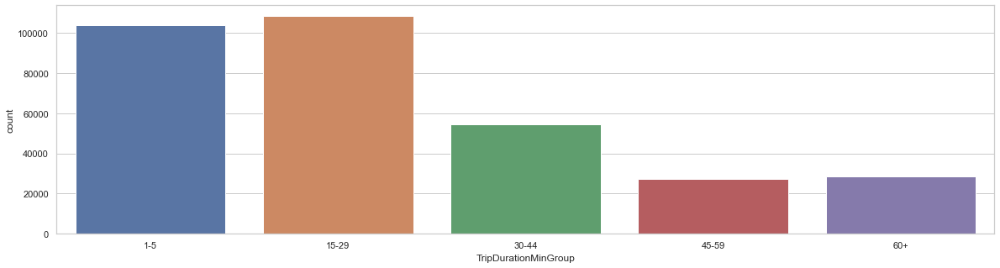

In [169]:
plt.figure(figsize = (20,5))
sns.countplot(x=df["TripDurationMinGroup"])
plt.show()

### Analisando Corridas Paralelas

Iremos levar em consideração um difereça de `30 segundos` entre as saídas, arredondando os minutos.

In [170]:
df_paralela = df[['starttime', 'stoptime', 'start station name', 'end station name']].copy()
df_paralela["starttime"] = df_paralela["starttime"].dt.round("min")
df_paralela["stoptime"] = df_paralela["stoptime"].dt.round("min")

In [171]:
df_paralela['User Row'] = df_paralela.index.astype(str)
df_paralela.head()

,starttime,stoptime,start station name,end station name,User Row
0,2020-01-01 00:05:00,2020-01-01 00:09:00,Grove St PATH,Newark Ave,0
1,2020-01-01 00:16:00,2020-01-01 00:22:00,Grove St PATH,Brunswick & 6th,1
2,2020-01-01 00:18:00,2020-01-01 00:22:00,Grove St PATH,Brunswick & 6th,2
3,2020-01-01 00:32:00,2020-01-01 00:39:00,Sip Ave,Astor Place,3
4,2020-01-01 00:46:00,2020-01-01 00:50:00,Grove St PATH,Marin Light Rail,4


In [172]:
df_2 = df_paralela.groupby(['starttime','stoptime','start station name','end station name'], as_index = False).agg({'User Row': ','.join}).reset_index(drop=True)
df_duplas = df_2[df_2['User Row'].str.contains(",")].reset_index(drop=True)
df_duplas

,starttime,stoptime,start station name,end station name,User Row
0,2020-01-01 01:00:00,2020-01-01 01:06:00,Columbus Dr at Exchange Pl,Washington St,"7,8"
1,2020-01-01 01:34:00,2020-01-01 01:45:00,Marin Light Rail,Warren St,"20,21"
2,2020-01-01 02:03:00,2020-01-01 02:07:00,Newark Ave,Monmouth and 6th,"24,25"
3,2020-01-01 10:39:00,2020-01-01 10:42:00,Hamilton Park,Manila & 1st,"76,77,78"
4,2020-01-01 11:12:00,2020-01-01 12:36:00,Jersey & 6th St,Hamilton Park,"95,96"
...,...,...,...,...,...
13826,2020-12-31 16:12:00,2020-12-31 16:38:00,Hoboken Ave at Monmouth St,Washington St,"336677,336678"
13827,2020-12-31 17:02:00,2020-12-31 17:13:00,Warren St,Van Vorst Park,"336704,336705"
13828,2020-12-31 17:27:00,2020-12-31 17:41:00,Brunswick St,Riverview Park,"336721,336722"
13829,2020-12-31 20:02:00,2020-12-31 20:03:00,Harborside,Columbus Dr at Exchange Pl,"336770,336771"


Como o cliente não possui identificador, estou usando a localização dele no conjunto de dados.

In [173]:
# Testando se os ciclistas sairam juntos
df.loc[7:8][['starttime', 'stoptime', 'start station name', 'end station name']]

,starttime,stoptime,start station name,end station name
7,2020-01-01 00:59:31.568,2020-01-01 01:06:15.351,Columbus Dr at Exchange Pl,Washington St
8,2020-01-01 00:59:34.420,2020-01-01 01:06:10.239,Columbus Dr at Exchange Pl,Washington St


### As 20 estações de origem mais escolhidas para sair em grupo

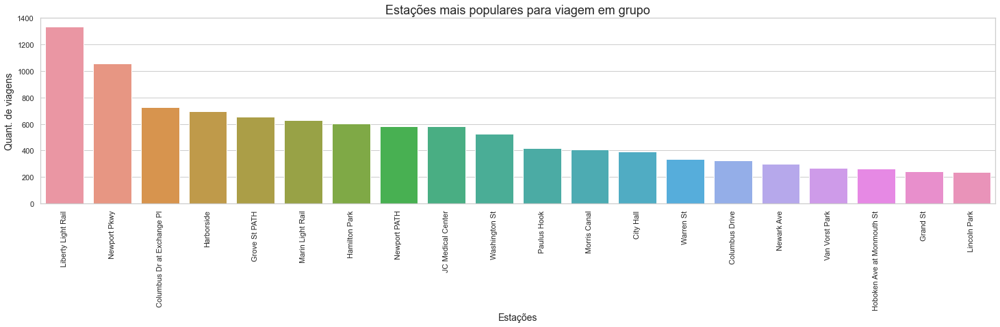

In [174]:
popularStation = df_duplas.groupby(['start station name']).size().sort_values(ascending=False).head(20)
plt.figure(figsize = (25,5))
ax = sns.barplot(x=popularStation.index, y=popularStation)
plt.xticks(rotation=90)
plt.title('Estações mais populares para viagem em grupo', fontsize=18)
plt.xlabel('Estações', fontsize=14)
plt.ylabel('Quant. de viagens', fontsize=14)
plt.show()

### As 20 rotas escolhidas para andar em grupo

In [175]:
trips = df_duplas.groupby(['start station name','end station name']).size().reset_index(name = 'Num. of Trips')
trips = trips.sort_values('Num. of Trips',ascending = False)
trips.head(20)

,start station name,end station name,Num. of Trips
966,Liberty Light Rail,Liberty Light Rail,675
1362,Newport Pkwy,Newport Pkwy,307
1087,Marin Light Rail,Marin Light Rail,197
755,JC Medical Center,JC Medical Center,195
603,Harborside,Harborside,161
248,Columbus Dr at Exchange Pl,Columbus Dr at Exchange Pl,149
1660,Washington St,Washington St,140
1011,Lincoln Park,Lincoln Park,134
1427,Paulus Hook,Paulus Hook,130
557,Hamilton Park,Hamilton Park,107


In [176]:
x = df_duplas['User Row'].str.split(',').agg(len).to_frame(name='Count')
df_duplas['Count'] = x
df_duplas

,starttime,stoptime,start station name,end station name,User Row,Count
0,2020-01-01 01:00:00,2020-01-01 01:06:00,Columbus Dr at Exchange Pl,Washington St,"7,8",2
1,2020-01-01 01:34:00,2020-01-01 01:45:00,Marin Light Rail,Warren St,"20,21",2
2,2020-01-01 02:03:00,2020-01-01 02:07:00,Newark Ave,Monmouth and 6th,"24,25",2
3,2020-01-01 10:39:00,2020-01-01 10:42:00,Hamilton Park,Manila & 1st,"76,77,78",3
4,2020-01-01 11:12:00,2020-01-01 12:36:00,Jersey & 6th St,Hamilton Park,"95,96",2
...,...,...,...,...,...,...
13826,2020-12-31 16:12:00,2020-12-31 16:38:00,Hoboken Ave at Monmouth St,Washington St,"336677,336678",2
13827,2020-12-31 17:02:00,2020-12-31 17:13:00,Warren St,Van Vorst Park,"336704,336705",2
13828,2020-12-31 17:27:00,2020-12-31 17:41:00,Brunswick St,Riverview Park,"336721,336722",2
13829,2020-12-31 20:02:00,2020-12-31 20:03:00,Harborside,Columbus Dr at Exchange Pl,"336770,336771",2


In [178]:
df[df['start station name'] == df['end station name']].shape[0]

50469

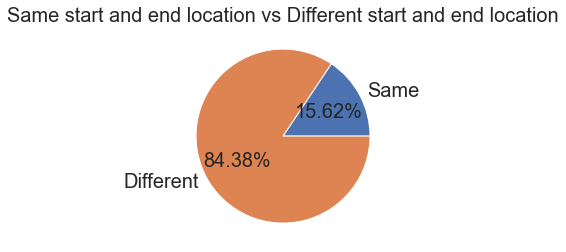

In [177]:
#number of trips that started and ended at same station
start_end_same = df[df['start station name'] == df['end station name']].shape[0]

#number of trips that started and ended at different station
start_end_diff = df.shape[0]-start_end_same

fig,ax=plt.subplots()
ax.pie([start_end_same,start_end_diff], labels=['Same', 'Different'], autopct='%1.2f%%', textprops={'fontsize': 20})
ax.set_title('Same start and end location vs Different start and end location', fontsize=20)



plt.show()